In [2]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation
import os
from torch.utils.data import Dataset
from PIL import Image
import healpy as hp
import tensorflow_graphics.geometry.transformation as tfg
from torchvision import transforms
from torch.utils.data import DataLoader
# from train import DATA_DIR, DEVICE, PARAMS_F
from bingham_vis.bc_dataloader import BottleCapDataset
from ipdf.ipdf import IPDF
from get_sample import get_sample

PARAMS_F = "ipdf/bc_full_200k.pth"
DEVICE = "cuda:0"

DATA_DIR = "bingham_vis/bc_data_large"
NUMBER_QUERIES = 200000
inches_per_subplot = 4
subset = ['Arrow', 'Circle', 'Cross', 'Diamond', 'Hexagon', 'Key', 'Line', 'Pentagon', 'U']
subset =['Cross']
NEG_SAMPLES = 1

2023-06-02 18:11:11.976917: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-06-02 18:11:12.113636: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-02 18:11:12.608920: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


WARN (bgl): source/blender/python/generic/bgl.c:2654 BPyInit_bgl: 'bgl' imported without an OpenGL backend. Please update your add-ons to use the 'gpu' module. In Blender 4.0 'bgl' will be removed.


In [3]:
to_image = True
def visualize_model_output(model_head,
                           images,
                           rotation_matrices_gt=None):
  """Display distributions over SO(3).
  Args:
    vision_model: The model which produces a feature vector to hand to IPDF.
    model_head: The IPDF model.
    images: A list of images.
    rotation_matrices_gt: A list of [N, 3, 3] tensors, representing the ground
      truth rotation matrices corresponding to the images.
  Returns:
    A tensor of images to output via Tensorboard.
  """
  return_images = []
  num_to_display = 5

  # vision_description = vision_model(torch.stack(images, 0), training=False)

  query_rotations, probabilities = model_head.output_pdf(images)
  inches_per_subplot = 4
  canonical_rotation = np.float32(Rotation.from_euler([0.2*3]).as_matrix())
  for image_index in range(num_to_display):
    fig = plt.figure(figsize=(3*inches_per_subplot, inches_per_subplot))
    gs = fig.add_gridspec(1, 3)
    fig.add_subplot(gs[0, 0])
    plt.imshow(images[image_index])
    plt.axis('off')
    ax2 = fig.add_subplot(gs[0, 1:], projection='mollweide')
    return_fig = visualize_so3_probabilities(
        query_rotations,
        probabilities[image_index],
        rotation_matrices_gt[image_index],
        ax=ax2,
        fig=fig,
        display_threshold_probability=1e-2 / query_rotations.shape[0],
        canonical_rotation=canonical_rotation)
    return_images.append(return_fig)
  return torch.concat(return_images, 0)


def visualize_so3_probabilities(rotations,
                                probabilities,
                                rotations_gt=None,
                                ax=None,
                                fig=None,
                                display_threshold_probability=0,
                                to_image=True,
                                show_color_wheel=True,
                                canonical_rotation=np.eye(3)):
  """Plot a single distribution on SO(3) using the tilt-colored method.
  Args:
    rotations: [N, 3, 3] tensor of rotation matrices
    probabilities: [N] tensor of probabilities
    rotations_gt: [N_gt, 3, 3] or [3, 3] ground truth rotation matrices
    ax: The matplotlib.pyplot.axis object to paint
    fig: The matplotlib.pyplot.figure object to paint
    display_threshold_probability: The probability threshold below which to omit
      the marker
    to_image: If True, return a tensor containing the pixels of the finished
      figure; if False return the figure itself
    show_color_wheel: If True, display the explanatory color wheel which matches
      color on the plot with tilt angle
    canonical_rotation: A [3, 3] rotation matrix representing the 'display
      rotation', to change the view of the distribution.  It rotates the
      canonical axes so that the view of SO(3) on the plot is different, which
      can help obtain a more informative view.
  Returns:
    A matplotlib.pyplot.figure object, or a tensor of pixels if to_image=True.
  """
  def _show_single_marker(ax, rotation, marker, edgecolors=True,
                          facecolors=False):
    eulers = Rotation.from_matrix(rotation).as_euler('xyz')
    xyz = rotation[:, 0]
    tilt_angle = eulers[0]
    longitude = np.arctan2(xyz[0], -xyz[1])
    latitude = np.arcsin(xyz[2])

    color = cmap(0.5 + tilt_angle / 2 / np.pi)
    ax.scatter(longitude, latitude, s=2500,
               edgecolors=color if edgecolors else 'none',
               facecolors=facecolors if facecolors else 'none',
               marker=marker,
               linewidth=4)

  if ax is None:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='mollweide')
  if rotations_gt is not None and len(rotations_gt.shape) == 2:
    rotations_gt = rotations_gt.unsqueeze(0)

  print("Rotations shape: ", rotations.shape)
  print("Canonical rotation: ", canonical_rotation.shape)
  display_rotations = rotations @ canonical_rotation
  cmap = plt.cm.hsv
  scatterpoint_scaling = 4e3

  eulers_queries = Rotation.from_matrix(display_rotations).as_euler('xyz')
  xyz = display_rotations[:, :, 0]
  tilt_angles = eulers_queries[:, 0]

  longitudes = np.arctan2(xyz[:, 0], -xyz[:, 1])
  latitudes = np.arcsin(xyz[:, 2])

  which_to_display = (probabilities > display_threshold_probability)

  if rotations_gt is not None:
    # The visualization is more comprehensible if the GT
    # rotation markers are behind the output with white filling the interior.
    display_rotations_gt = rotations_gt @ canonical_rotation

    for rotation in display_rotations_gt:
      _show_single_marker(ax, rotation, 'o')
    # Cover up the centers with white markers
    for rotation in display_rotations_gt:
      _show_single_marker(ax, rotation, 'o', edgecolors=False,
                          facecolors='#ffffff')
  

  # Display the distribution
  ax.scatter(
      longitudes[which_to_display],
      latitudes[which_to_display],
      s=scatterpoint_scaling * probabilities[which_to_display],
      c=cmap(0.5 + tilt_angles[which_to_display] / 2. / np.pi))

  ax.grid()
  ax.set_xticklabels([])
  ax.set_yticklabels([])

  if show_color_wheel:
    # Add a color wheel showing the tilt angle to color conversion.
    ax = fig.add_axes([0.86, 0.17, 0.12, 0.12], projection='polar')
    theta = np.linspace(-3 * np.pi / 2, np.pi / 2, 200)
    radii = np.linspace(0.4, 0.5, 2)
    _, theta_grid = np.meshgrid(radii, theta)
    colormap_val = 0.5 + theta_grid / np.pi / 2.
    ax.pcolormesh(theta, radii, colormap_val.T, cmap=cmap)
    ax.set_yticklabels([])
    ax.set_xticklabels([r'90$\degree$', None,
                        r'180$\degree$', None,
                        r'270$\degree$', None,
                        r'0$\degree$'], fontsize=14)
    ax.spines['polar'].set_visible(False)
    plt.text(0.5, 0.5, 'Tilt', fontsize=14,
             horizontalalignment='center',
             verticalalignment='center', transform=ax.transAxes)

  return fig

Shape of R_grid:  torch.Size([862488, 3, 3])
Read blend: bingham_vis/FilesForKu/Line_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing RoamingLight
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Rendering 1 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Rendering 26 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 51 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 64 / 64 samples
Saved: 'test.png'
 Time: 00:00.02 (Saving: 00:00.00)

Rotations shape:  (862488, 3, 3)
Canonical rotation:  (3, 3)


/tmp/ipykernel_334094/3122989037.py:140: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([r'90$\degree$', None,


Read blend: bingham_vis/FilesForKu/Line_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing RoamingLight
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Rendering 1 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Rendering 26 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 51 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 64 / 64 samples
Saved: 'test.png'
 Time: 00:00.02 (Saving: 00:00.00)

Rotations shape:  (862488, 3, 3)
Canonical rotation:  (3, 3)
Read blend: bingham_vis/FilesForKu/Line_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:

/tmp/ipykernel_334094/1340363528.py:142: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(3*inches_per_subplot, inches_per_subplot))


Read blend: bingham_vis/FilesForKu/Line_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing RoamingLight
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Rendering 1 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 26 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 51 / 64 samples
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.01 | Rendering 64 / 64 samples
Saved: 'test.png'
 Time: 00:00.02 (Saving: 00:00.00)

Rotations shape:  (862488, 3, 3)
Canonical rotation:  (3, 3)
Read blend: bingham_vis/FilesForKu/Line_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:

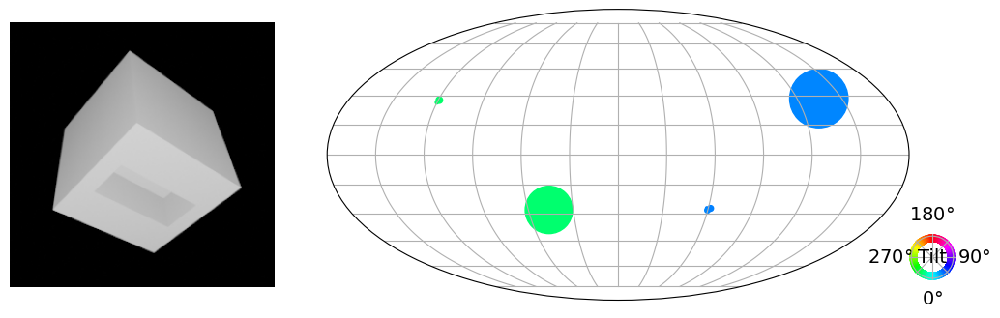

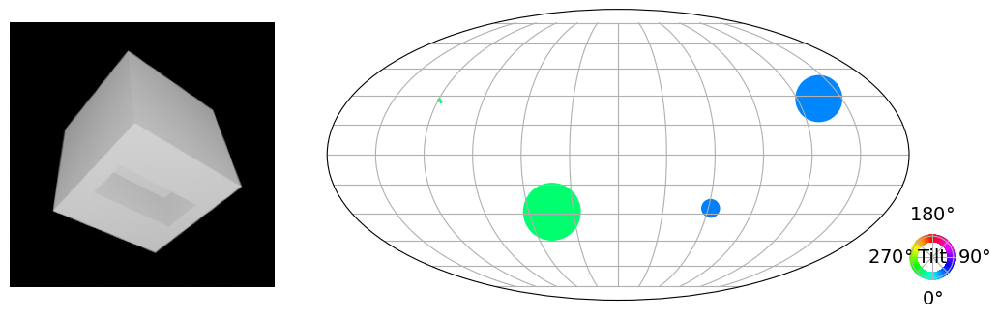

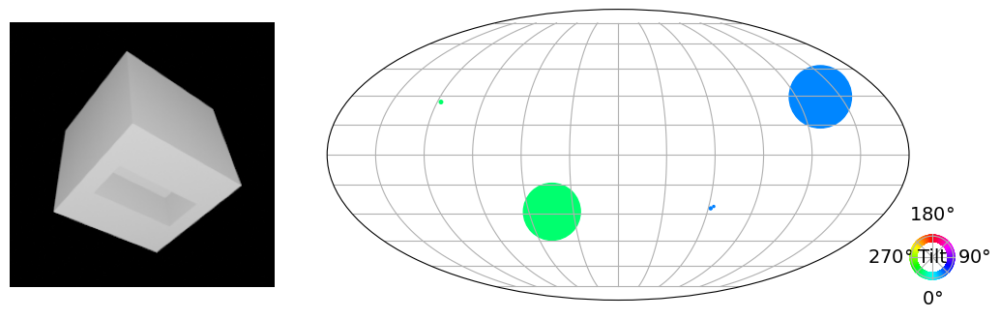

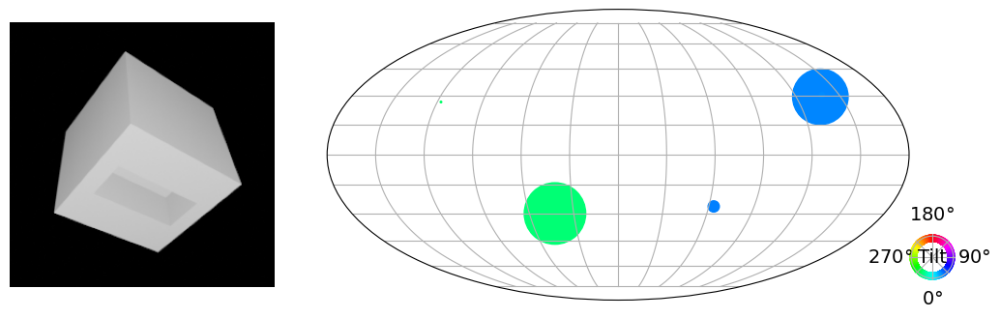

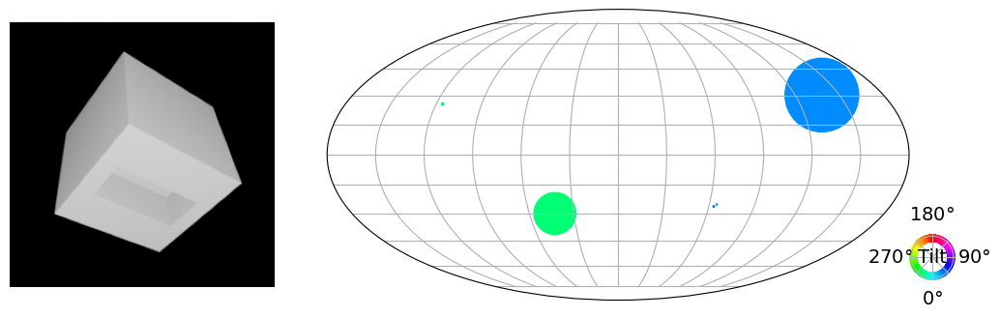

...

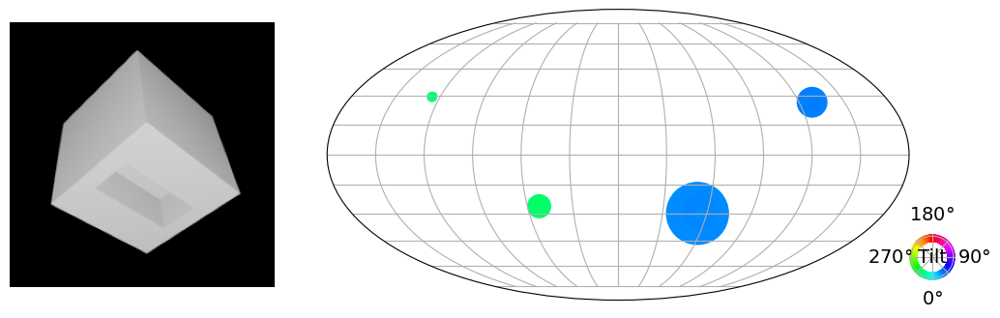

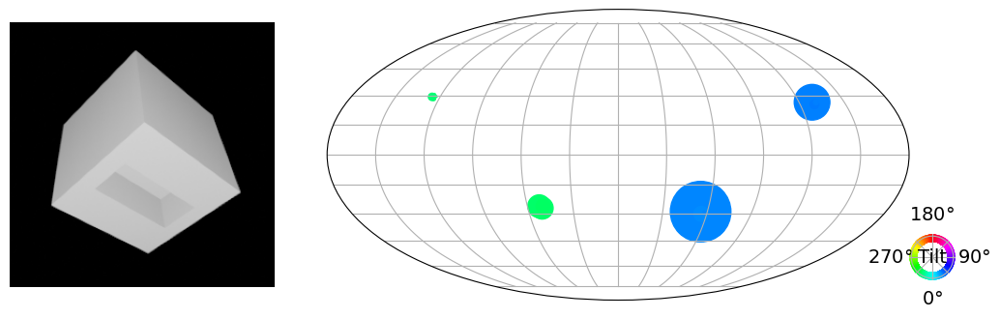

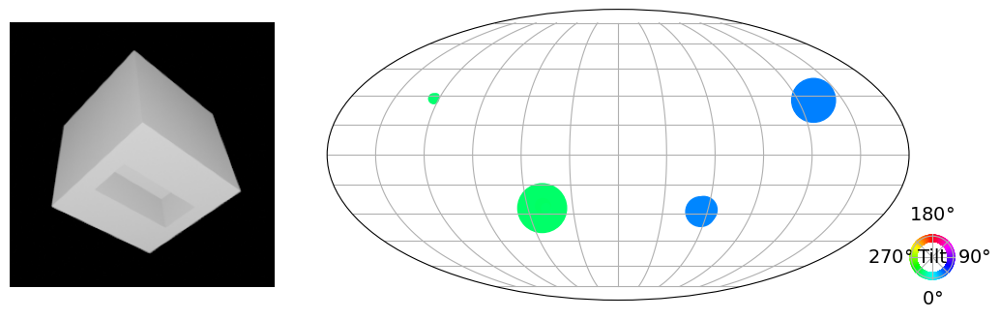

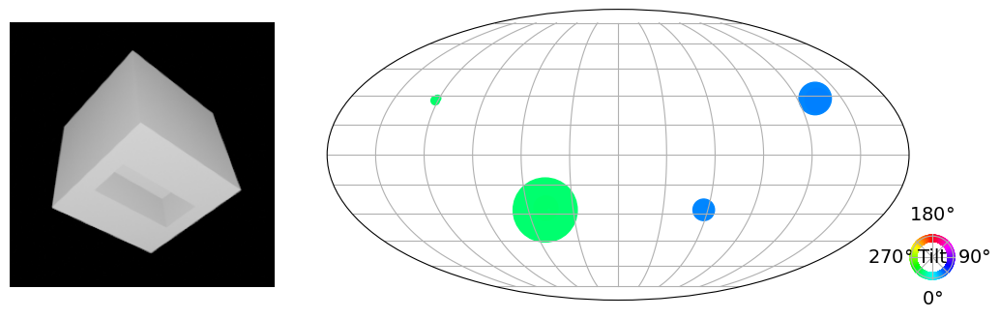

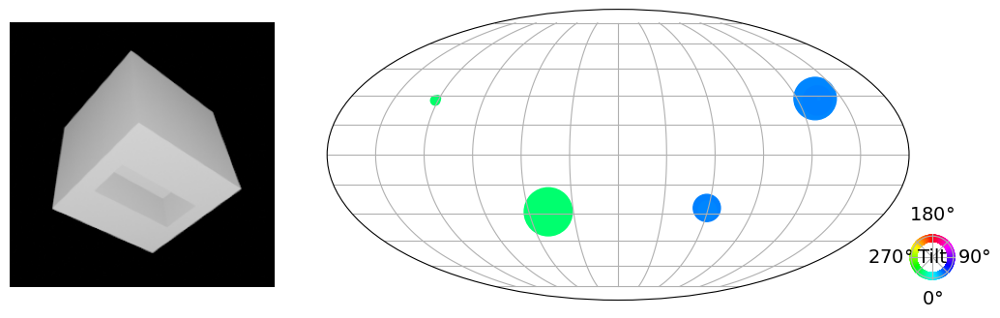

In [8]:
def compare_rotations():
    # Replicating code here: https://github.com/google-research/google-research/blob/4d906a25489bb7859a88d982a6c5e68dd890139b/implicit_pdf/models.py#L380
    # with SciPy and NumPy functions.
    recursion_level = 1
    number_per_side = 2**recursion_level
    number_pix = hp.nside2npix(number_per_side)
    s2_points = hp.pix2vec(number_per_side, np.arange(number_pix))
    s2_points = np.stack([*s2_points], 1)

    azimuths = np.arctan2(s2_points[:, 1], s2_points[:, 0])
    polars = np.arccos(s2_points[:, 2])
    tilts = np.linspace(0, 2 * np.pi, 6 * 2**recursion_level, endpoint=False)

    # IPDF.
    zeros = np.zeros(number_pix)
    R1s_tf = tfg.rotation_matrix_3d.from_euler(np.stack([azimuths, zeros, zeros], 1))
    R2s_tf = tfg.rotation_matrix_3d.from_euler(np.stack([zeros, zeros, polars], 1))
    R1_R2s_tf = R1s_tf @ R2s_tf
    Rs_tf = []
    for tilt in tilts:
        R3_tf = tfg.rotation_matrix_3d.from_euler([[tilt, 0, 0]])
        R1_R2s_R3_tf = R1_R2s_tf @ R3_tf
        Rs_tf.append(R1_R2s_R3_tf)

    Rs_tf = np.concatenate(Rs_tf)

    # Mine.
    R1s_sp = Rotation.from_euler("X", azimuths).as_matrix()
    R2s_sp = Rotation.from_euler("Z", polars).as_matrix()
    R3s_sp = Rotation.from_euler("X", tilts).as_matrix()
    Rs_sp = np.einsum("bij,tjk->tbik", R1s_sp @ R2s_sp, R3s_sp).reshape(-1, 3, 3)

    assert np.all(np.isclose(Rs_tf, Rs_sp))


def generate_healpix_grid(recursion_level=None, size=None):
    # See: # https://github.com/google-research/google-research/blob/4d906a25489bb7859a88d982a6c5e68dd890139b/implicit_pdf/models.py#L380.
    # I replaced TensorFlow functions with functions from SciPy and NumPy.
    assert not (recursion_level is None and size is None)
    if size:
        recursion_level = max(int(np.round(np.log(size / 72.0) / np.log(8.0))), 0)

    number_per_side = 2**recursion_level
    number_pix = hp.nside2npix(number_per_side)
    s2_points = hp.pix2vec(number_per_side, np.arange(number_pix))
    s2_points = np.stack([*s2_points], 1)

    azimuths = np.arctan2(s2_points[:, 1], s2_points[:, 0])
    polars = np.arccos(s2_points[:, 2])
    tilts = np.linspace(0, 2 * np.pi, 6 * 2**recursion_level, endpoint=False)

    R1s = Rotation.from_euler("X", azimuths).as_matrix()
    R2s = Rotation.from_euler("Z", polars).as_matrix()
    R3s = Rotation.from_euler("X", tilts).as_matrix()

    Rs = np.einsum("bij,tjk->tbik", R1s @ R2s, R3s).reshape(-1, 3, 3)
    return Rs

resolution = 1

def main():
    # See: https://github.com/google-research/google-research/blob/4d906a25489bb7859a88d982a6c5e68dd890139b/implicit_pdf/models.py#L272
    # and Section 3.4/Figure 2.
    grid_sizes = 72 * 8 ** np.arange(7)
    size = grid_sizes[np.argmin(np.abs(np.log(NUMBER_QUERIES) - np.log(grid_sizes)))]
    size = 294912
    # size = 2359296
    # print("GRid sizes: ", grid_sizes)
    # print("Shape of size: ", size)
    # R_grid = generate_healpix_grid(size=size)
    # R_grid = torch.from_numpy(R_grid).float().to(DEVICE)
    # print("Shape of R_grid: ", R_grid.shape)
    model = IPDF().to(DEVICE)
    model.load_state_dict(torch.load(PARAMS_F))
    model.eval()

    MIN = -np.pi / 3
    MAX = np.pi / 3
    # STEP = np.pi / 18

    # Randomly sample H orientations
    # STEP = int((MAX - MIN) / (size ** (1 / 3)))
    count = int(size ** (1/3))
    # print(STEP)

    # x_rots = np.arange(MIN,MAX,STEP)
    x_rots = np.linspace(MIN, MAX, num = count)
    y_rots = np.linspace(MIN, MAX, num = count)
    z_rots = np.linspace(0, np.pi * 2, num = 3 * count)
    # y_rots = np.arange(MIN,MAX,STEP)
    # z_rots = np.arange(0,2 * np.pi, STEP // 3)

    R_grid = np.zeros((len(x_rots), len(y_rots), len(z_rots), 3, 3))
    for i, x_rot in enumerate(x_rots):
        for j, y_rot in enumerate(y_rots):
            for k, z_rot in enumerate(z_rots):
                R_grid[i, j, k] = Rotation.from_euler('XYZ', [x_rot, y_rot, z_rot], degrees=False).as_matrix()
    
    R_grid = R_grid.reshape(-1, 3, 3)
    R_grid = torch.from_numpy(R_grid).float().to(DEVICE)
    print("Shape of R_grid: ", R_grid.shape)

    #valid_dataset = SymmetricSolidsDataset(DATA_DIR, "test", SYMSOL_I, 1)

    #valid_dataset = BottleCapDataset(DATA_DIR, subset, NEG_SAMPLES, False, type='test')
    #valid_dataset = BottleCapDataset(DATA_DIR, "Circle_cube", 1)
    #valid_loader = DataLoader(dataset=valid_dataset, batch_size=1)

    # preprocess_transforms = transforms.Compose(
    #         [
    #             transforms.ToTensor(),
    #             #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
    #             #transforms.Resize((224, 224))
    #         ]
    #     )
    preprocess_transforms = transforms.ToTensor()

    rot = Rotation.from_euler('XYZ', [0, 0, resolution], degrees=True).as_matrix()
    #orientation = Rotation.from_euler('XYZ', [np.pi / 6, np.pi / 12, 0], degrees=False).as_matrix()
    orientation = np.eye(3)
    orientation = np.array([[ 0.6340455,  -0.7703015,   0.06798469],
                            [ 0.60924256,  0.4434557,  -0.6573968 ],
                            [ 0.47624552,  0.45823863,  0.75047153]])

    with torch.no_grad():
        for i in range(360 // resolution):

            R_grid_old = R_grid
            R_grid_new = R_grid.reshape(1, -1, 9)
            im_pil = get_sample("Line", 'Bottle', orientation)
            # plt.imshow(im_pil)
            # plt.show()
            im_t = preprocess_transforms(im_pil)
            im_t = im_t.unsqueeze(0)
            im_t = im_t.to(DEVICE)

            query_rotations, probabilities = model.output_pdf(im_t.to(DEVICE), R_grid_new.to(DEVICE))

            query_rotations = query_rotations.cpu().numpy()
            probabilities = probabilities.cpu().numpy()

            fig = plt.figure(figsize=(3*inches_per_subplot, inches_per_subplot))
            gs = fig.add_gridspec(1, 3)
            fig.add_subplot(gs[0, 0])
            plt.imshow(im_t[0].permute(1,2,0).cpu().numpy())
            plt.axis('off')
            ax2 = fig.add_subplot(gs[0, 1:], projection='mollweide')
            visualize_so3_probabilities(
                R_grid_old.cpu().numpy(),
                probabilities[0],
                ax=ax2,
                fig=fig,
                display_threshold_probability=1e-4 / query_rotations.shape[0],)
            #plt.show()
            plt.savefig("line_bottle_guesses_newgrid/line_{}.png".format(i))
            orientation = orientation @ rot


main()

In [ ]:
rot = Rotation.from_euler('xyz', [0, 0, 1], degrees=True).as_matrix()
orientation = np.eye(3)
for i in range(360):
    orientation = np.dot(orientation, rot)
    im = get_sample("Arrow", "Cap", orientation)
    # Save image as i.png
    im.save("arrow_rotated/{}.png".format(i))

Read blend: bingham_vis/FilesForKu/Arrow_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Syncing RoamingLight
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Rendering 1 / 64 samples
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.02 | Rendering 26 / 64 samples
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.03 | Rendering 51 / 64 samples
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.03 | Rendering 64 / 64 samples
Saved: 'test.png'
 Time: 00:00.04 (Saving: 00:00.01)

Read blend: bingham_vis/FilesForKu/Arrow_cube_bottle.blend
Fra:1 Mem:12.22M (Peak 12.22M) | Time:00:00.00 | Syncing Bottle
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Syncing Camera
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Syncing Main Axis
Fra:1 Mem:12.23M (Peak 12.23M) | Time:00:00.00 | Syncing RoamingLight

In [9]:
# Load the images n.png in arrow_rotated as a gif
images = []
images_fast = []
for i in range(360 // resolution):
    images.append(Image.open("line_bottle_guesses_newgrid/line_{}.png".format(i)))
    if i % 2 == 0:
        images_fast.append(Image.open("line_bottle_guesses_newgrid/line_{}.png".format(i)))
images[0].save('line_bottle_guesses_newgrid/line_rotated.gif',   save_all=True, append_images=images[1:], optimize=False, duration=40, loop=0)
images_fast[0].save('line_bottle_guesses_newgrid/line_rotated_fast.gif',   save_all=True, append_images=images_fast[1:], optimize=False, duration=40, loop=0)

